#Preliminaries
just some boiler code which is needed to run the Detr model ...

In [12]:
!nvidia-smi

Fri Oct 25 17:28:17 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.94                 Driver Version: 560.94         CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3060 ...  WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   54C    P8             11W /   75W |      51MiB /   6144MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [13]:
import math

from PIL import Image
import requests
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'

import ipywidgets as widgets
from IPython.display import display, clear_output

import torch
from torch import nn
from torchvision.models import resnet50
import torchvision.transforms as T
torch.set_grad_enabled(False)

In [14]:
# COCO classes
CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]

# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

In [15]:
# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [16]:
def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

# Detection using DETR (pre-trained)


In [17]:
model = torch.hub.load('facebookresearch/detr', 'detr_resnet50', pretrained=True)
model.eval()

Using cache found in C:\Users\chowd/.cache\torch\hub\facebookresearch_detr_main


DETR(
  (transformer): Transformer(
    (encoder): TransformerEncoder(
      (layers): ModuleList(
        (0-5): 6 x TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
      )
    )
    (decoder): TransformerDecoder(
      (layers): ModuleList(
        (0-5): 6 x TransformerDecoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=256, ou

In [18]:
print(model.config.id2label)

AttributeError: 'DETR' object has no attribute 'config'

In [8]:
!pip install supervision

In [9]:
import os
import requests
import supervision as sv

Bounding boxes: tensor([[ 4.7302e-03,  2.0694e+02,  1.1907e+02,  3.6680e+02],
        [ 3.6613e+02,  2.9576e+02,  5.8758e+02,  4.7761e+02],
        [ 5.3472e+02,  1.0161e+02,  5.9879e+02,  1.5415e+02],
        [ 1.0350e+02,  1.2919e+02,  1.8560e+02,  2.1570e+02],
        [ 4.5242e+02, -3.3195e-02,  5.8631e+02,  1.0550e+02],
        [ 2.5158e+02,  4.1480e+01,  4.2731e+02,  1.2093e+02],
        [ 1.6144e+02,  2.0511e+02,  3.0417e+02,  3.2800e+02],
        [ 4.4724e+02,  4.3834e+01,  5.0648e+02,  1.0035e+02],
        [ 9.1944e+01,  1.9146e+02,  1.5953e+02,  2.6843e+02],
        [ 5.2428e+02,  4.1837e-01,  6.3971e+02,  1.3535e+02],
        [-4.9191e-02,  7.1193e-02,  5.7558e+01,  6.2805e+01],
        [ 5.0725e+02,  2.0585e+02,  6.3508e+02,  3.1172e+02],
        [ 2.2968e+02,  1.0971e+02,  2.9419e+02,  1.9290e+02],
        [ 1.3110e+02,  1.0689e+02,  1.7990e+02,  1.4674e+02],
        [ 4.0612e+02,  5.7082e+01,  4.5759e+02,  1.0456e+02]])
Scores: tensor([0.9022, 0.9811, 0.8881, 0.9156, 0.898

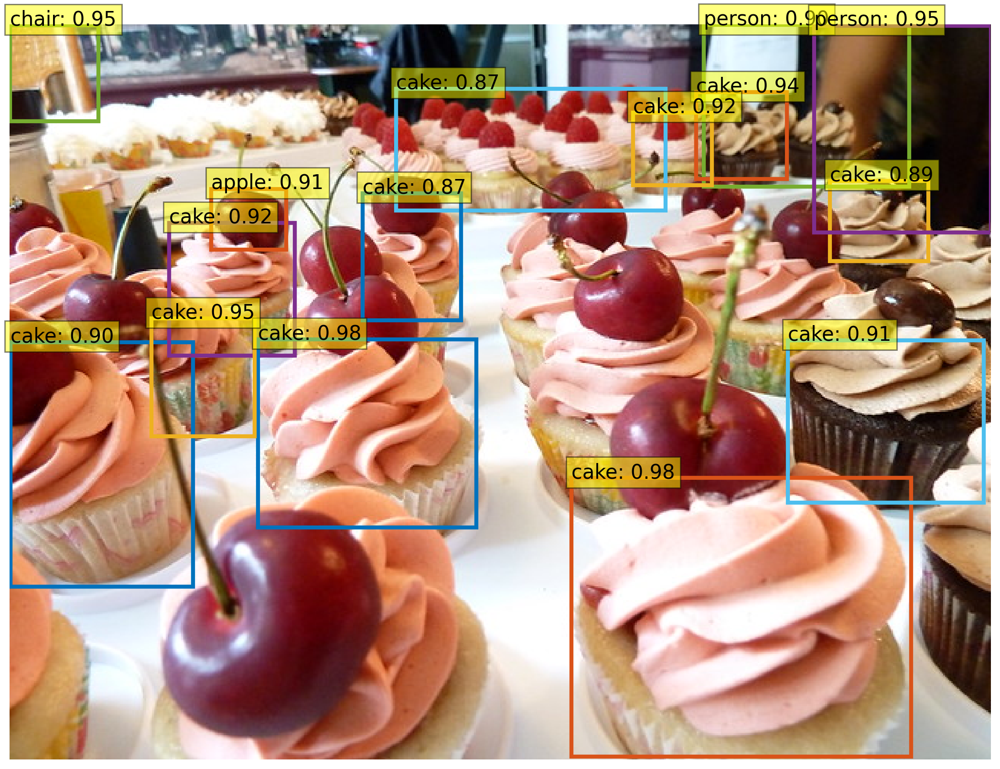

Bounding boxes: tensor([[-1.6977e-01,  1.9278e+00,  6.3881e+02,  4.2239e+02],
        [ 6.0304e+01,  3.8183e-02,  2.2170e+02,  8.5062e+01],
        [ 1.6460e+01,  7.8478e+01,  6.3293e+02,  2.5789e+02]])
Scores: tensor([0.9751, 0.9947, 0.9656])
Classes: tensor([67, 46, 51])


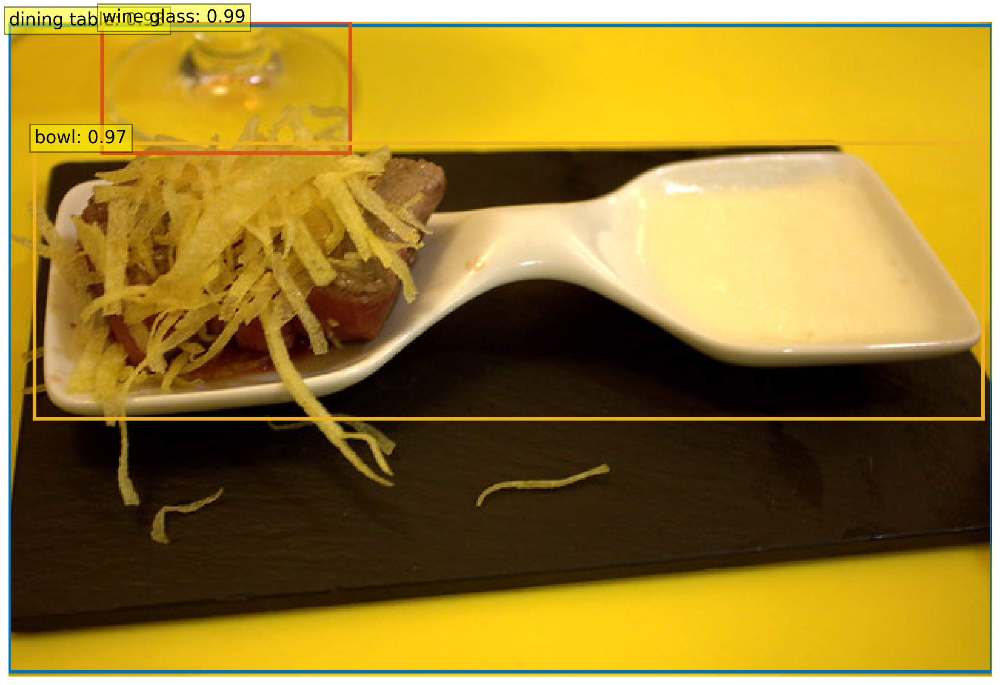

Bounding boxes: tensor([[ 8.6902e+01,  1.0674e+02,  2.4315e+02,  3.1467e+02],
        [-3.3799e-02,  7.9331e+01,  4.2686e+02,  6.3293e+02],
        [ 1.3720e+02,  3.3626e+02,  3.6464e+02,  4.9026e+02]])
Scores: tensor([0.9990, 0.9578, 0.9788])
Classes: tensor([47, 67, 61])


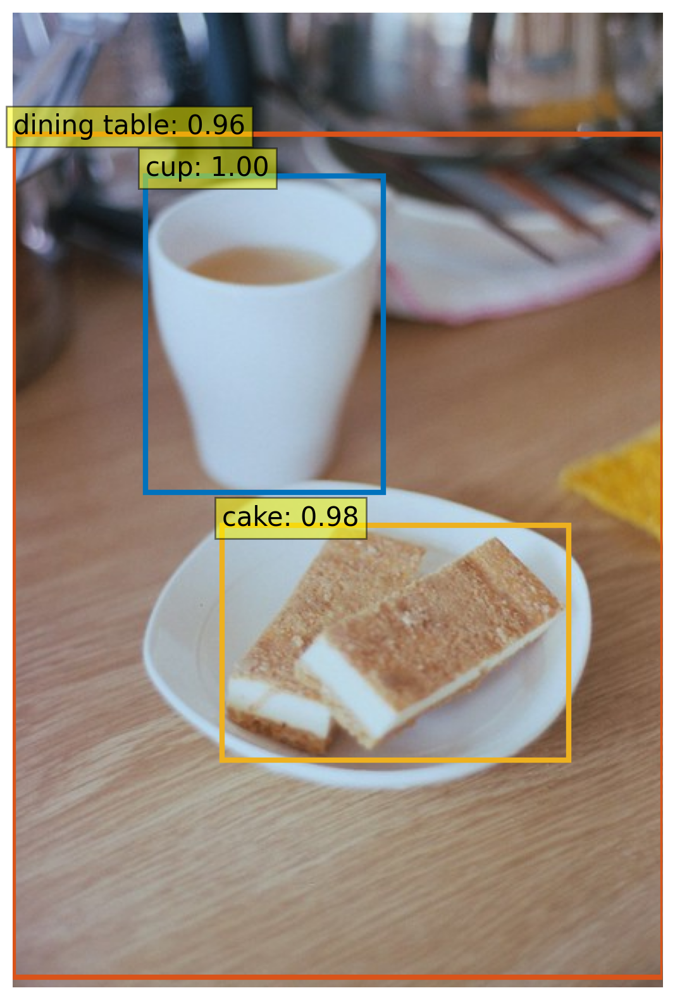

Bounding boxes: tensor([[ 47.1152, 247.6373,  70.1930, 259.4515],
        [  9.0534, 279.8948, 106.0467, 386.6917],
        [ 53.1988, 179.0717, 139.0468, 270.2440],
        [  9.9385, 249.2924,  26.8734, 260.8971],
        [220.3829, 248.3462, 250.4601, 297.0403],
        [135.4838, 267.5270, 216.5115, 372.8135],
        [339.7717, 219.9636, 346.4356, 235.0553],
        [337.9713, 203.9128, 347.6861, 233.2810],
        [210.3374, 230.0674, 235.1990, 257.8611],
        [ 10.3253, 256.7083, 206.0191, 345.1595],
        [158.5354, 249.7344, 175.5994, 263.0676],
        [ 81.9521, 231.4848, 106.4785, 270.1031],
        [119.9485, 248.3648, 139.9330, 260.3561]])
Scores: tensor([0.9129, 0.9964, 0.9574, 0.9473, 0.9251, 0.9977, 0.8805, 0.8842, 0.8896,
        0.9950, 0.9806, 0.9922, 0.9771])
Classes: tensor([62, 62, 64, 62, 62, 62, 86, 64, 62, 67, 62, 86, 62])


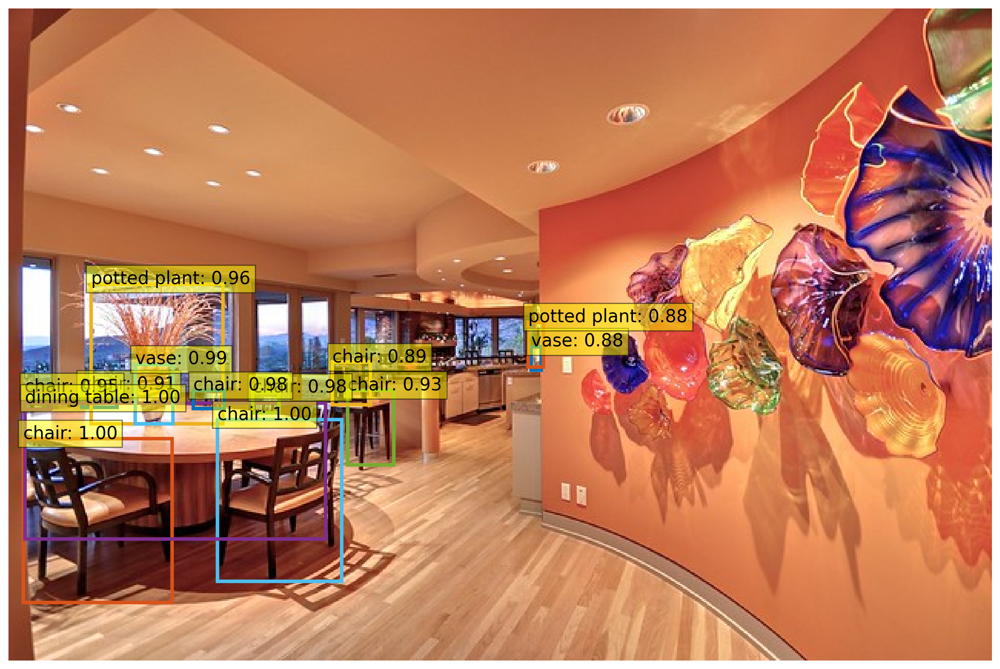

Bounding boxes: tensor([[ 70.6089, 117.0957, 289.3629, 367.9127],
        [333.6924, 120.2096, 567.6399, 370.8322]])
Scores: tensor([0.9976, 0.9983])
Classes: tensor([62, 62])


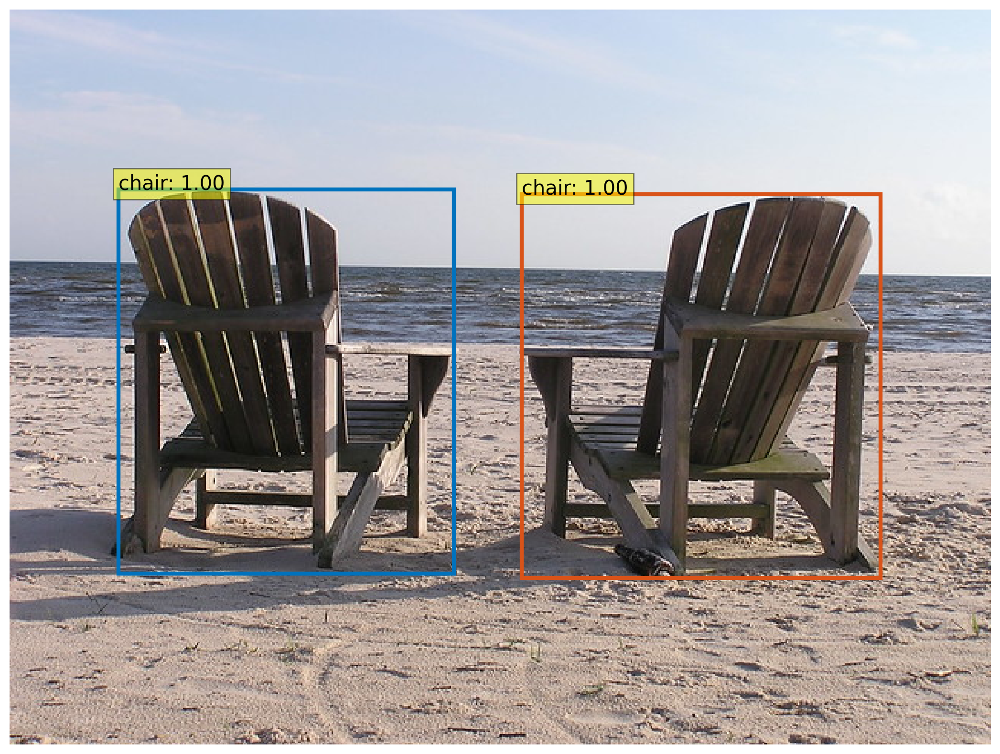

Bounding boxes: tensor([[4.1875e+00, 8.4611e+01, 1.2900e+02, 2.3281e+02],
        [6.4414e+00, 8.4002e+01, 1.3127e+02, 1.9525e+02],
        [4.1613e+02, 2.1578e+01, 5.3933e+02, 1.3452e+02],
        [3.9440e+02, 3.3082e+02, 5.9933e+02, 6.3205e+02],
        [4.3373e+02, 2.5924e+02, 6.1790e+02, 4.4565e+02],
        [5.2086e+02, 8.0016e+01, 6.4019e+02, 2.2076e+02],
        [9.8720e+01, 2.4351e+02, 2.4561e+02, 4.0190e+02],
        [4.9510e+02, 2.0222e+02, 6.3986e+02, 3.6042e+02],
        [4.9358e+01, 1.4984e+02, 1.8311e+02, 2.8756e+02],
        [3.7516e+02, 8.0793e+01, 5.1234e+02, 2.2292e+02],
        [3.0284e-01, 2.4054e+02, 8.7216e+01, 3.5893e+02],
        [1.8037e+02, 1.9687e+01, 2.9133e+02, 1.2111e+02],
        [3.7538e+02, 7.9131e+01, 5.1427e+02, 2.6168e+02],
        [4.4985e+01, 4.0731e+02, 3.1109e+02, 6.3414e+02],
        [2.3759e+02, 8.0106e+01, 3.6863e+02, 2.0476e+02],
        [1.1481e+02, 8.3452e+01, 2.4001e+02, 2.2414e+02],
        [3.3116e+00, 3.0696e+02, 1.7274e+02, 4.4895e+02]

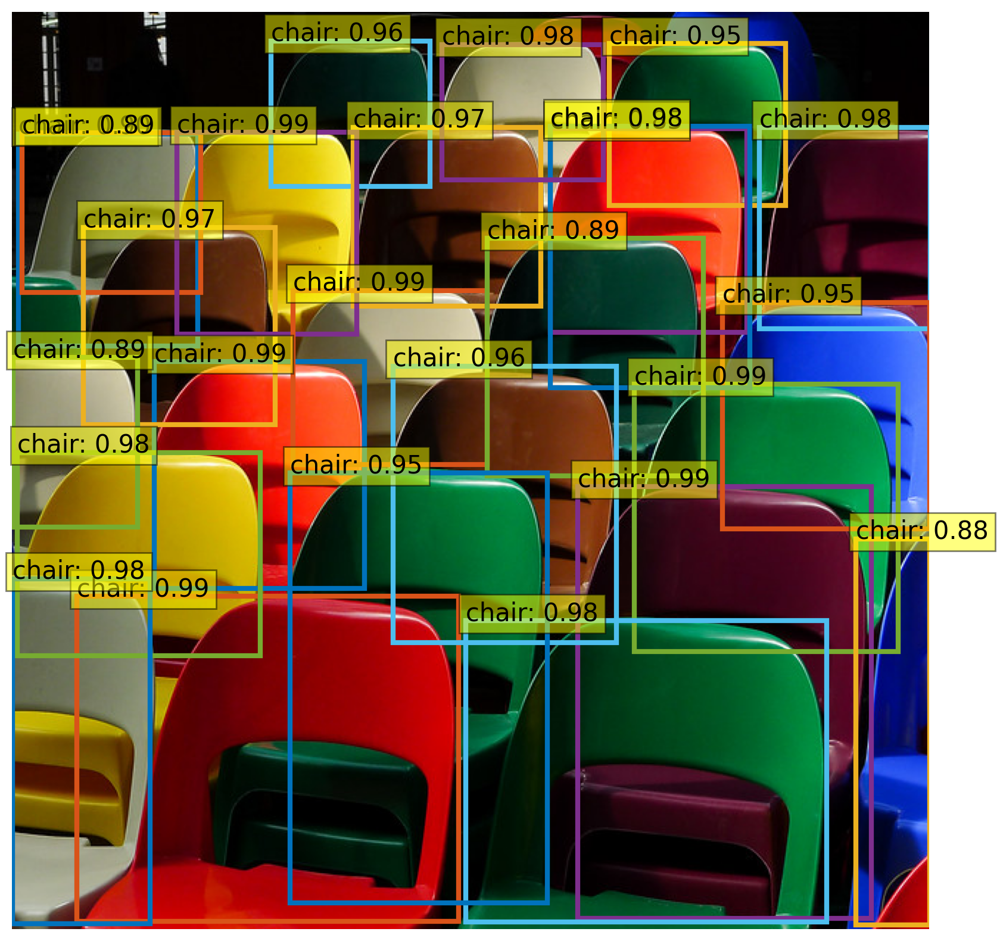

Bounding boxes: tensor([[122.3371, 501.0526, 613.7152, 637.3150]])
Scores: tensor([0.8765])
Classes: tensor([84])


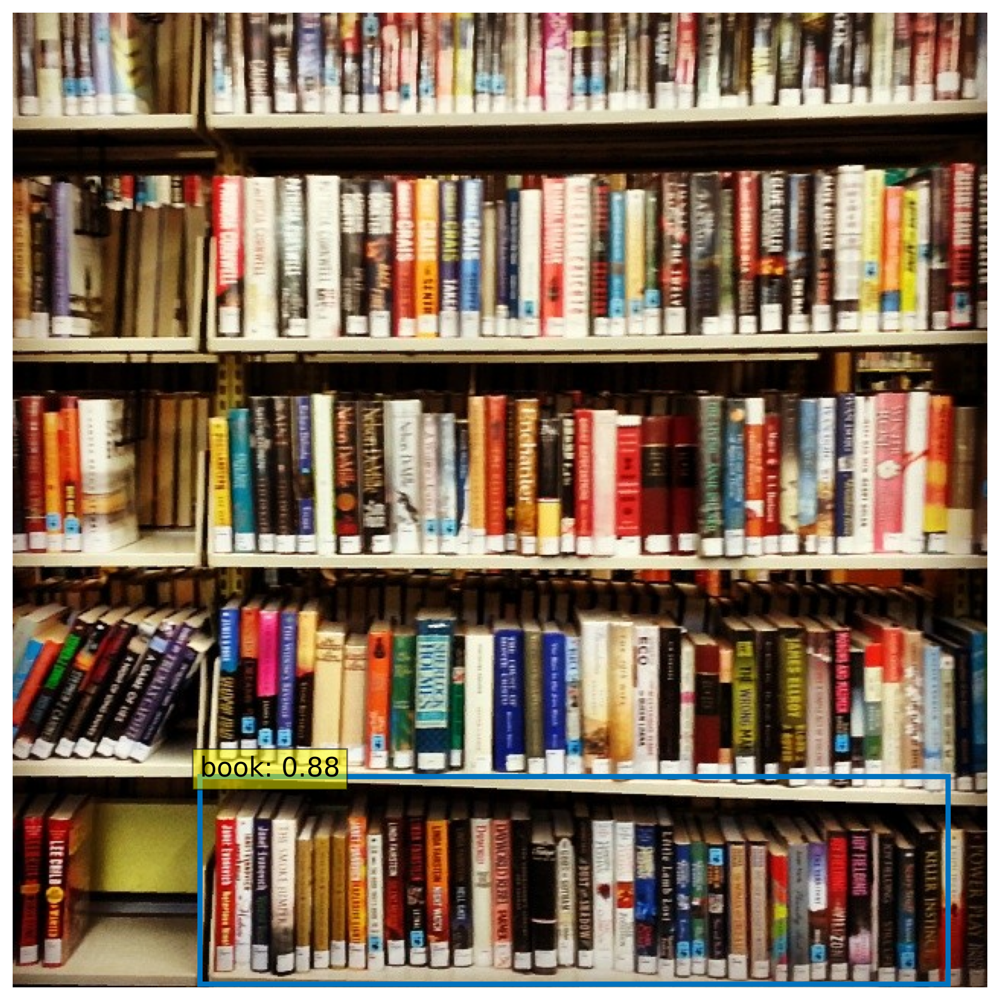

Bounding boxes: tensor([[ 8.1828e+01,  1.7335e+02,  2.2227e+02,  3.0692e+02],
        [-1.4462e-01, -1.8210e-02,  6.3985e+02,  4.7993e+02],
        [ 4.4865e+02,  7.4519e+01,  6.2577e+02,  2.4397e+02]])
Scores: tensor([0.9982, 0.9683, 0.9952])
Classes: tensor([60, 67, 51])


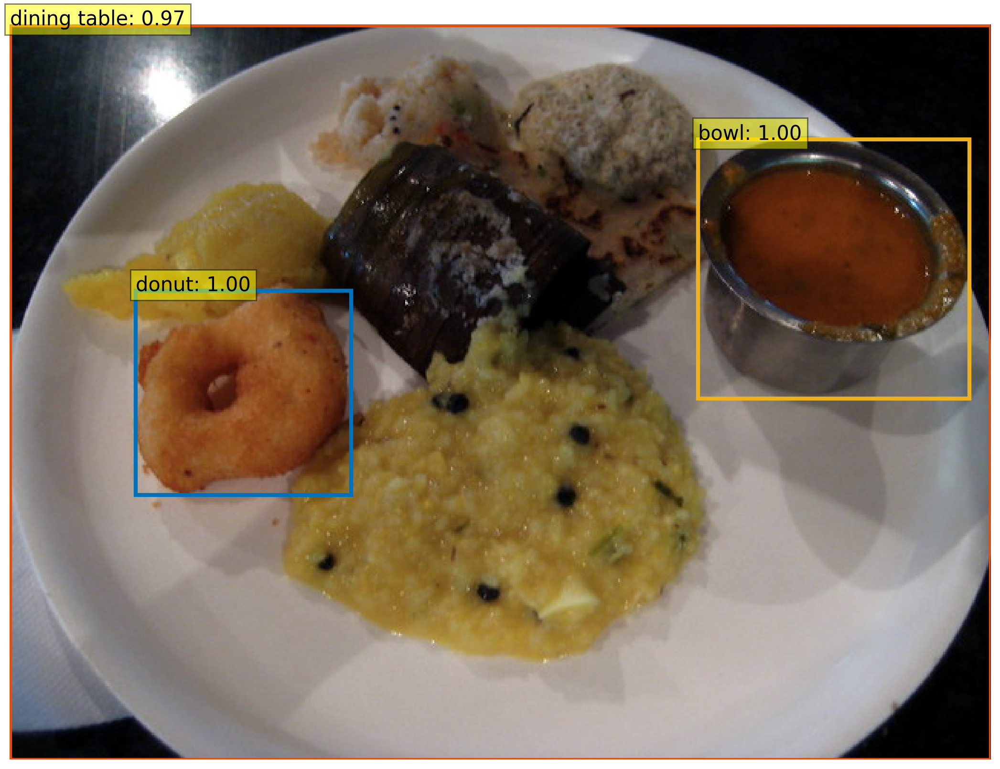

Bounding boxes: tensor([[1.5889e+03, 1.7179e+03, 2.3907e+03, 2.4013e+03],
        [1.4505e+03, 9.0904e+02, 2.1535e+03, 1.7032e+03],
        [2.7391e+03, 2.3763e+02, 3.5689e+03, 7.1317e+02],
        [1.2764e+03, 2.2698e+03, 2.2231e+03, 2.9355e+03],
        [4.1949e+02, 1.3451e+03, 1.7234e+03, 2.3516e+03],
        [9.0480e-01, 5.5597e+00, 6.7149e+02, 1.3159e+03],
        [2.1785e+03, 2.2703e+03, 3.0689e+03, 2.9798e+03],
        [1.8182e+03, 7.1737e+02, 2.8738e+03, 1.4335e+03],
        [2.7367e+02, 1.3704e+03, 5.3973e+02, 1.6312e+03]])
Scores: tensor([0.9829, 0.9966, 0.9884, 0.9799, 0.9962, 0.8533, 0.9971, 0.9976, 0.8570])
Classes: tensor([60, 47, 51, 60, 51,  1, 60, 51, 53])


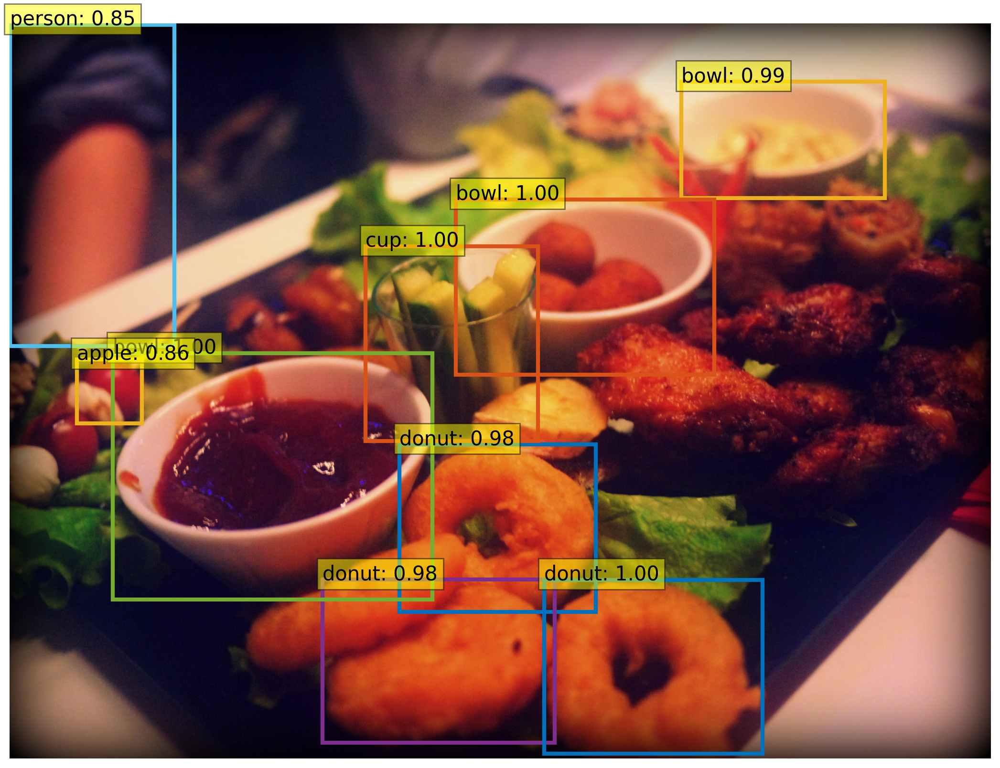

Bounding boxes: tensor([], size=(0, 4))
Scores: tensor([])
Classes: tensor([], dtype=torch.int64)


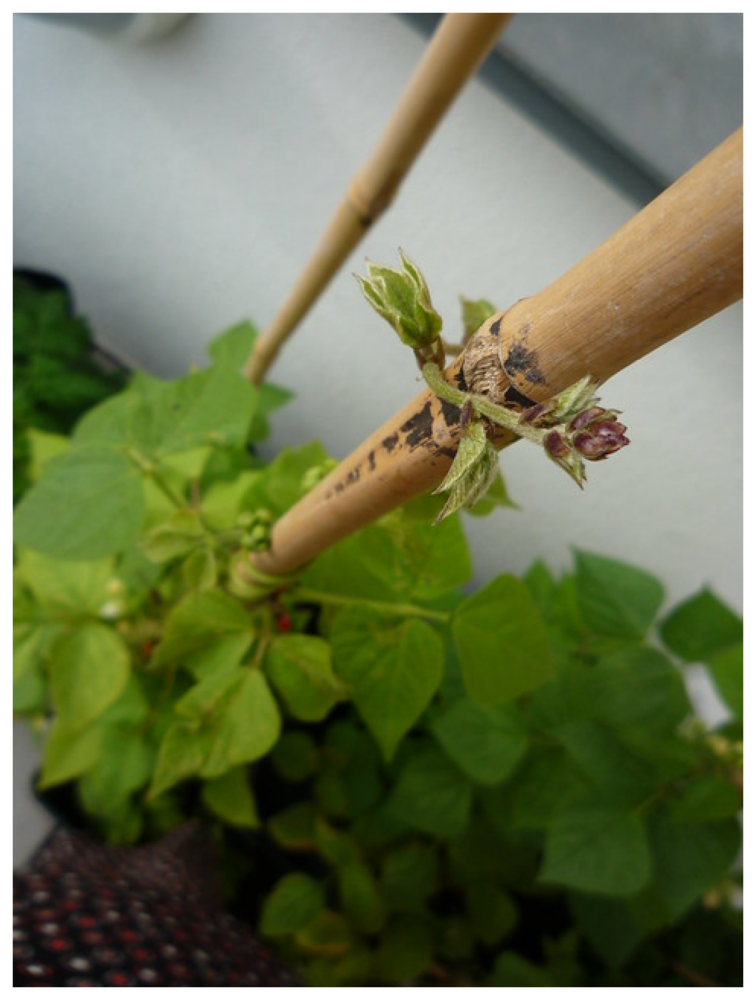

Bounding boxes: tensor([[ 1.8966e+02,  2.7953e+02,  2.9198e+02,  4.3903e+02],
        [-1.2837e-01,  2.4071e+00,  6.3885e+02,  4.7798e+02],
        [ 2.9371e+02,  1.5954e+02,  3.7444e+02,  3.2574e+02]])
Scores: tensor([0.9942, 0.9043, 0.9995])
Classes: tensor([64, 72,  1])


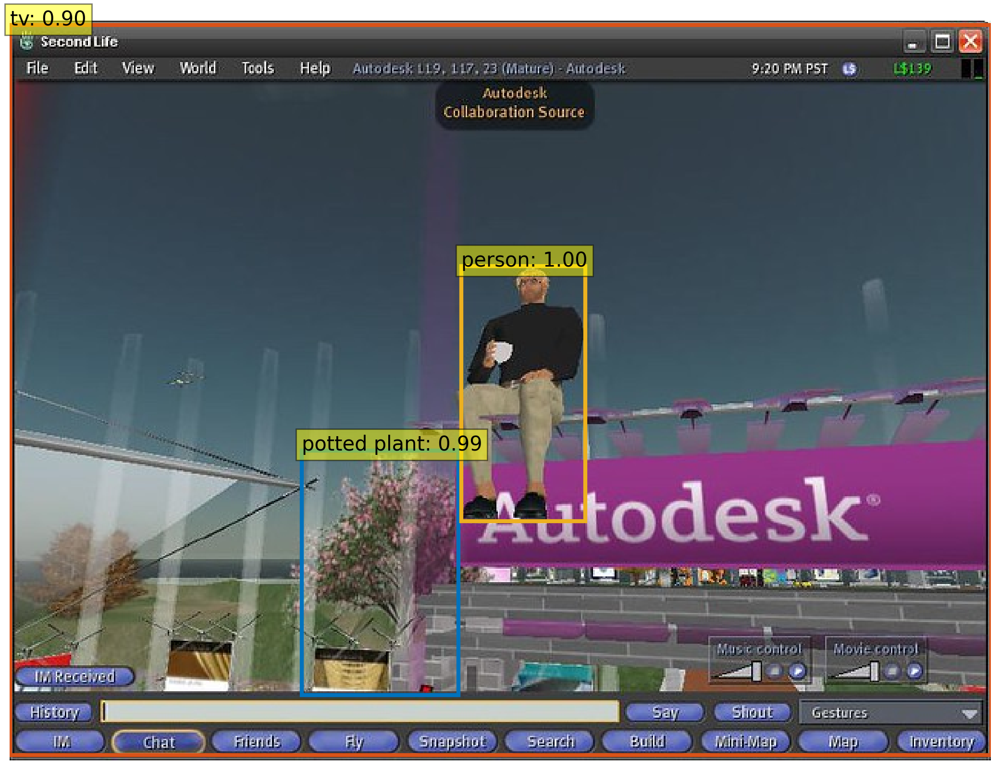

Bounding boxes: tensor([[6.6330e-02, 2.1262e+02, 3.1482e+01, 2.7867e+02],
        [1.6280e+02, 1.5940e+02, 1.9655e+02, 2.1565e+02],
        [1.3526e+01, 1.7346e+02, 6.1323e+01, 2.6944e+02]])
Scores: tensor([0.9260, 0.9979, 0.9992])
Classes: tensor([2, 1, 1])


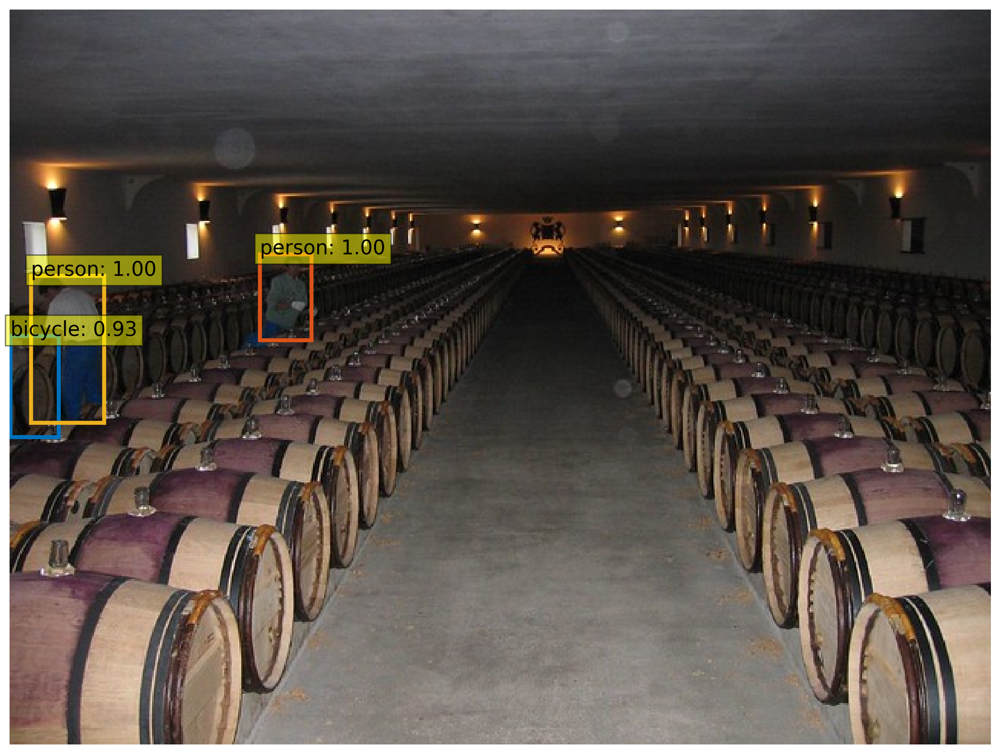

Bounding boxes: tensor([[ 33.9917, 470.6269, 276.4600, 626.4619],
        [242.1843, 384.7238, 488.4419, 615.5977]])
Scores: tensor([0.8581, 0.8786])
Classes: tensor([61, 84])


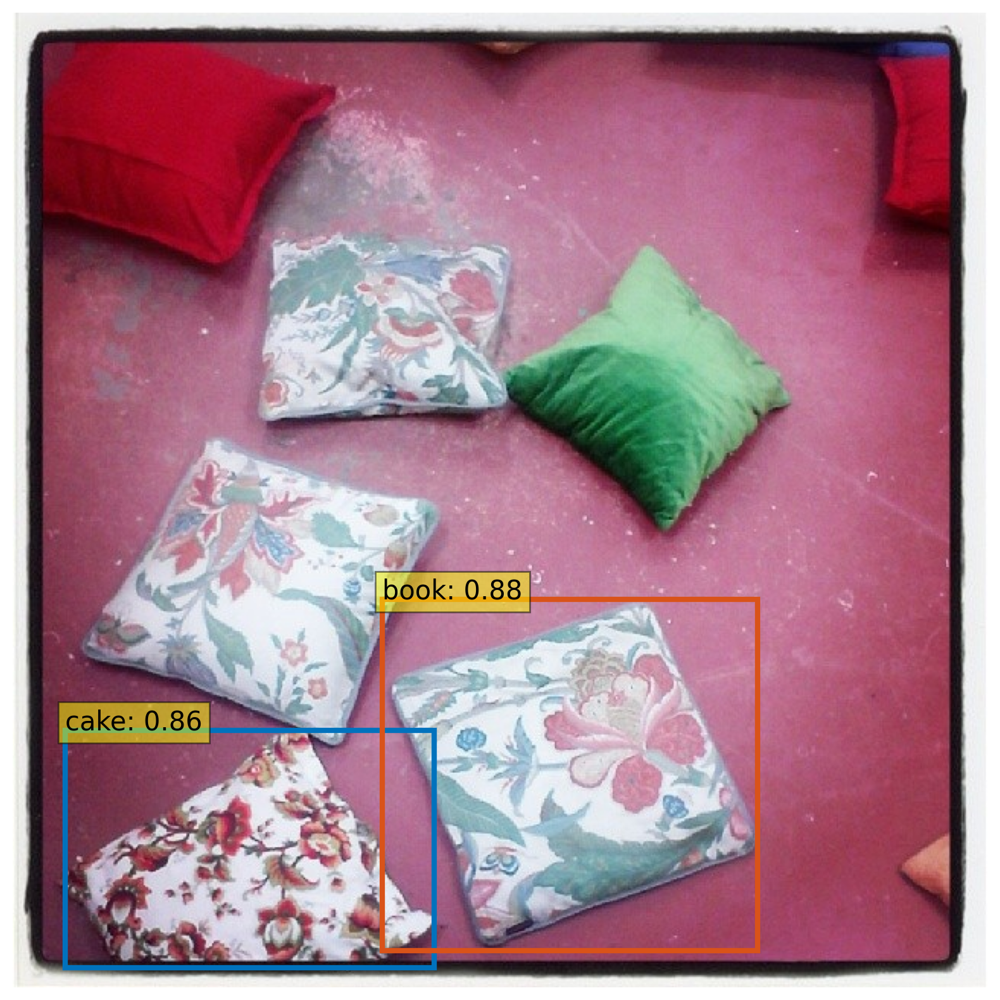

Bounding boxes: tensor([[462.7387, 117.4725, 568.4370, 183.4649]])
Scores: tensor([0.8541])
Classes: tensor([84])


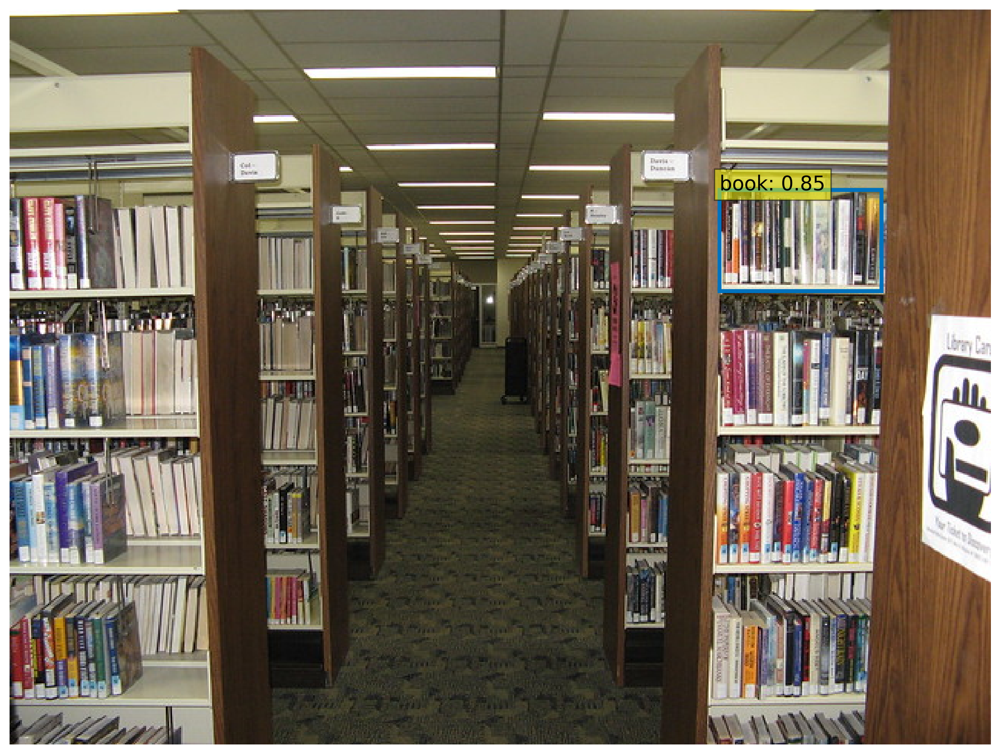

Bounding boxes: tensor([[ 15.9359, 453.4851, 104.3588, 487.1871],
        [214.8972, 206.4820, 241.0365, 229.4332],
        [ 10.2551, 433.9230,  96.4215, 466.9949]])
Scores: tensor([0.8860, 0.8782, 0.8591])
Classes: tensor([84, 84, 84])


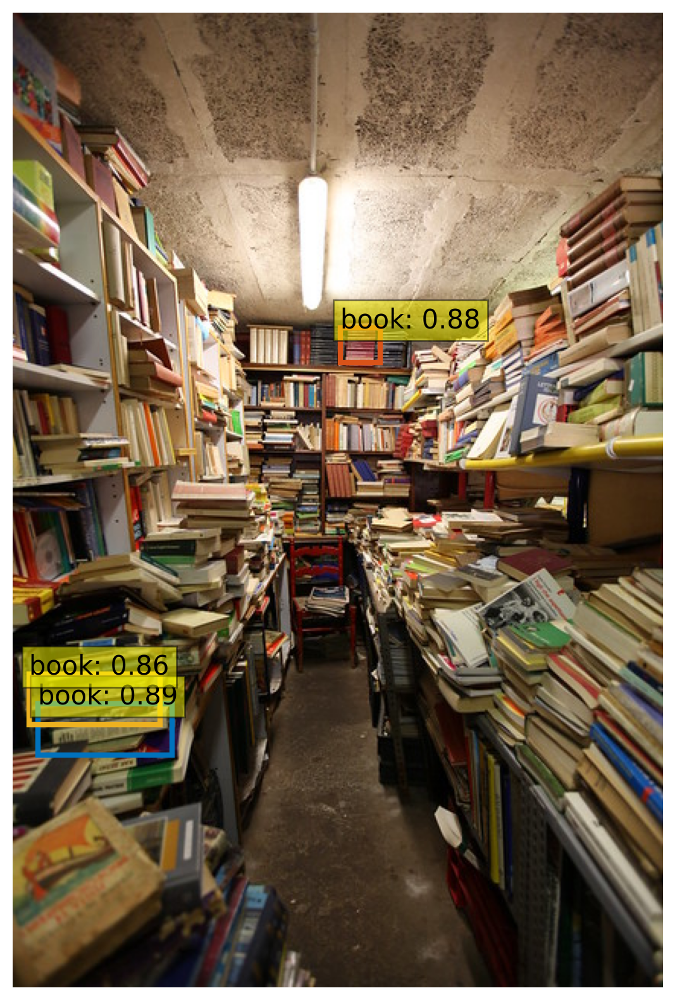

Bounding boxes: tensor([[189.5447,  65.1948, 402.3895, 268.3041],
        [129.5335, 128.7783, 621.3004, 342.8137]])
Scores: tensor([0.9764, 0.9008])
Classes: tensor([1, 9])


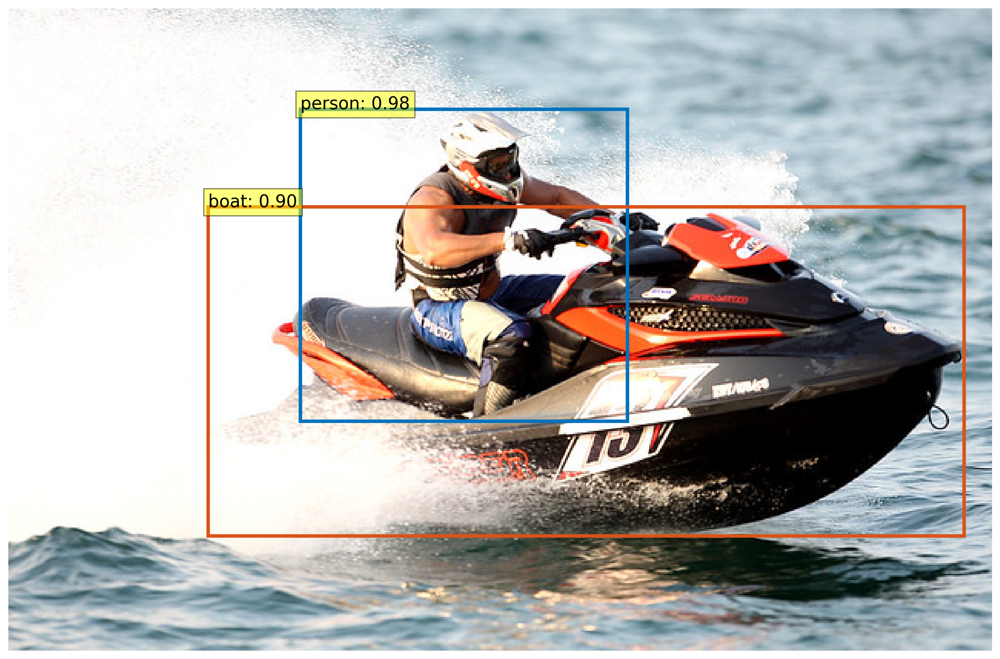

Bounding boxes: tensor([], size=(0, 4))
Scores: tensor([])
Classes: tensor([], dtype=torch.int64)


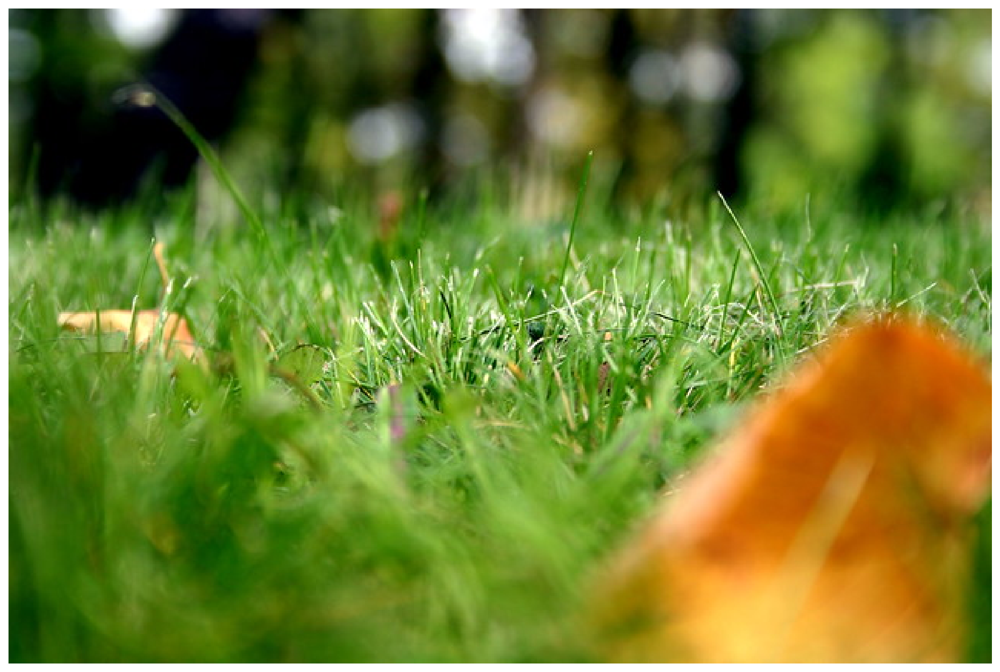

Bounding boxes: tensor([[4.7631e+02, 4.4190e-02, 5.1150e+02, 9.4759e+01],
        [1.5969e+02, 4.6565e-01, 3.0847e+02, 1.2535e+02],
        [1.1749e+02, 8.0816e-01, 2.2912e+02, 2.7268e+02],
        [3.2389e+01, 1.5423e-01, 1.2601e+02, 5.0238e+01],
        [4.8581e+02, 3.6158e-02, 5.7751e+02, 5.1850e+01],
        [7.9945e+01, 6.9883e+01, 6.3974e+02, 4.2263e+02],
        [4.4180e+02, 1.4325e+00, 4.9569e+02, 1.3073e+02],
        [4.8811e+02, 1.6274e+01, 5.4761e+02, 1.3509e+02]])
Scores: tensor([0.8904, 0.9303, 0.9984, 0.8839, 0.8715, 0.9927, 0.9956, 0.9920])
Classes: tensor([44, 62, 44, 62, 62, 67, 44, 44])


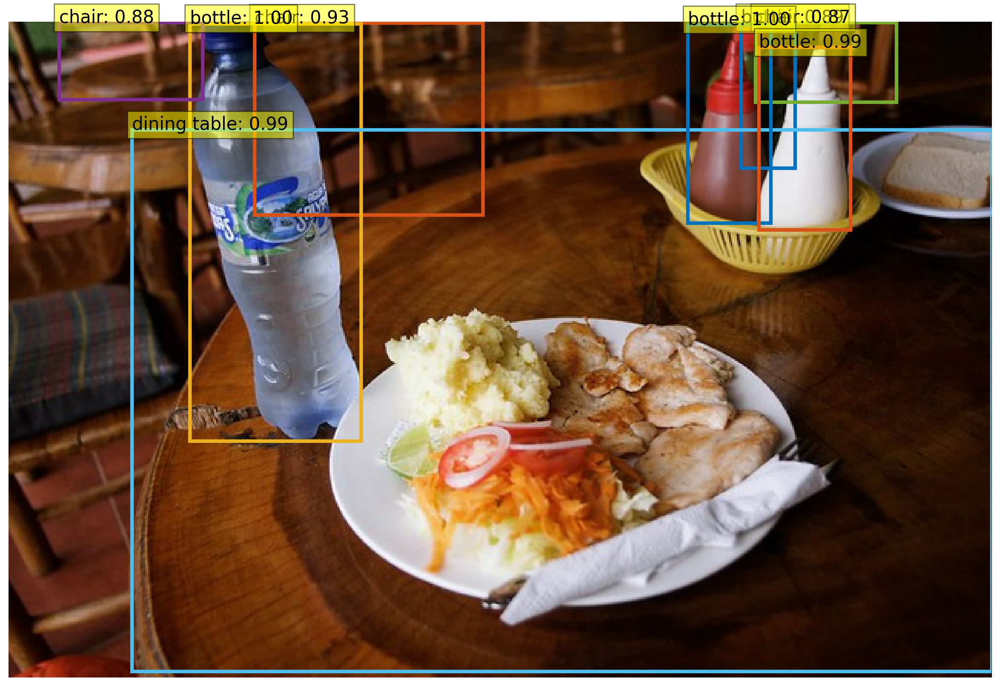

Bounding boxes: tensor([[143.2305, 194.7160, 299.7390, 326.2150],
        [ 48.3863,   1.7279, 425.9482, 629.6360]])
Scores: tensor([0.9237, 0.9987])
Classes: tensor([61,  1])


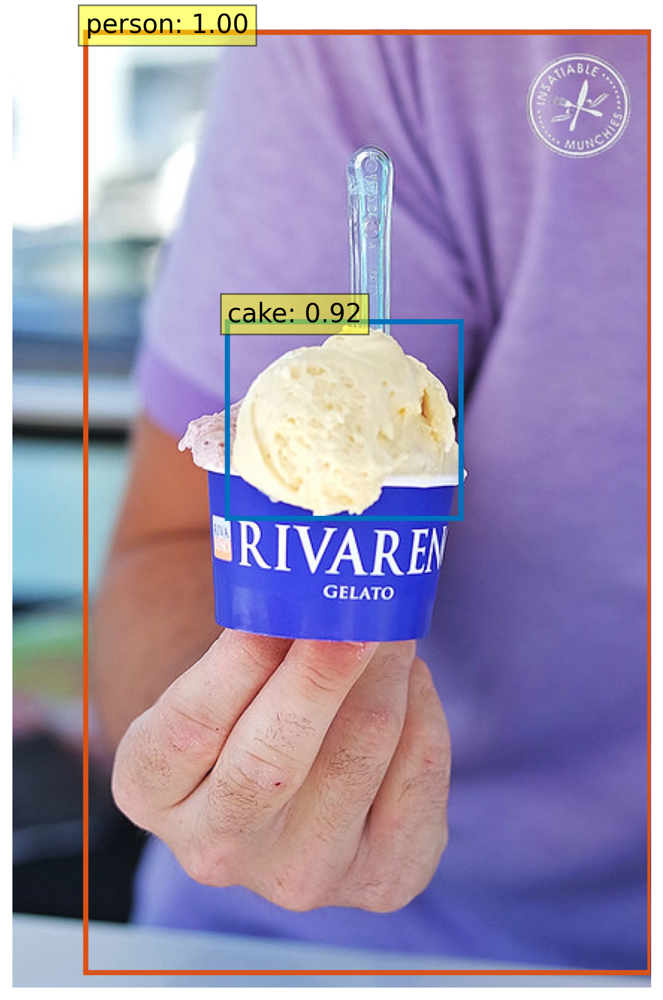

Bounding boxes: tensor([[ 117.4976,  906.7532,  135.0108,  952.0265],
        [1058.9363,  875.3196, 1076.3062,  903.3562],
        [1211.5283,  843.1746, 1253.0797,  867.7847],
        [ 816.7839,  839.3900,  849.7163,  858.1154],
        [1013.0892,  874.5911, 1033.1000,  903.7465],
        [ 637.4052,  905.3713,  659.7315,  949.0295],
        [ 630.6382,  832.4061,  658.3751,  856.6813],
        [ 212.1702,  869.7452,  267.7802,  909.2584],
        [1533.2797,  880.0733, 1562.2809,  922.8369],
        [1681.4813, 1196.6084, 2031.3027, 1519.2218],
        [1382.1654,  881.7237, 1415.3938,  935.9998],
        [ 678.5603,  911.2867,  701.4280,  953.0319],
        [ 936.5692,  830.6864,  996.6730,  864.3588],
        [ 954.5085,  983.3724, 1014.1609, 1071.5316],
        [ 716.1105,  913.7929,  739.6003,  955.2256],
        [1371.9288,  884.2030, 1418.7290,  908.9508],
        [1572.5085,  880.0110, 1625.1964,  915.7532],
        [ 143.1068,  904.6101,  160.7841,  951.0884],
        [ 67

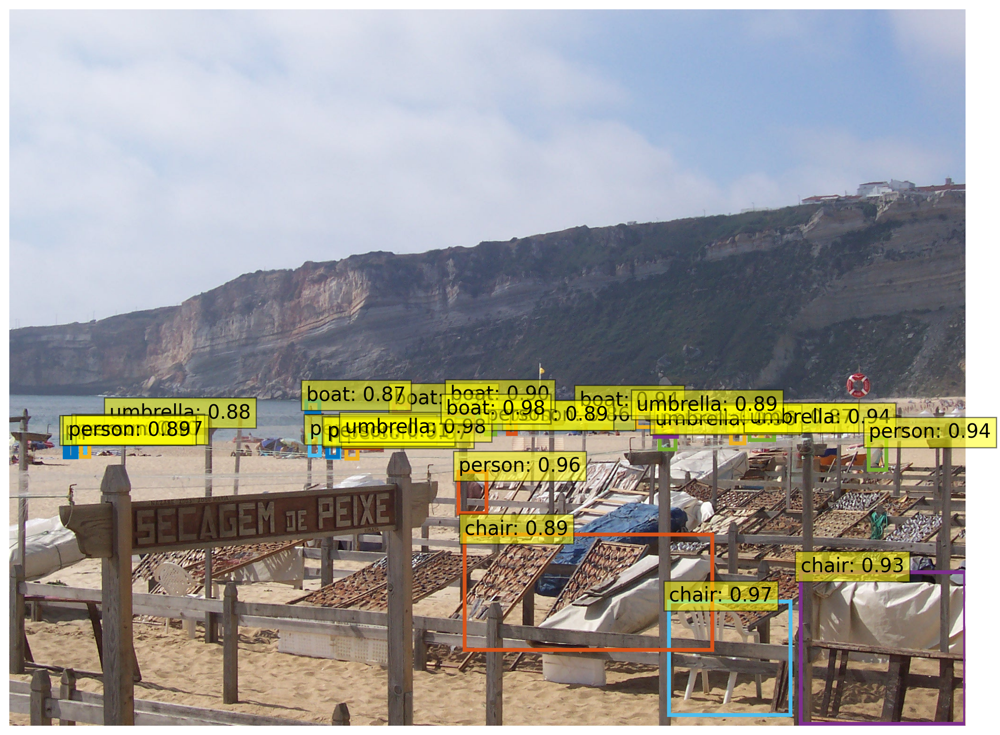

In [11]:
# Loop through all files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        # Create the full file path
        image_path = os.path.join(folder_path, filename)
        im = Image.open(image_path)

        # mean-std normalize the input image (batch-size: 1)
        img = transform(im).unsqueeze(0)

        # propagate through the model
        outputs = model(img)

        # keep only predictions with 0.7+ confidence
        probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
        keep = probas.max(-1).values > 0.85

        # convert boxes from [0; 1] to image scales
        bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

        # Print the bounding boxes, scores, and class predictions
        print("Bounding boxes:", bboxes_scaled)
        print("Scores:", probas[keep].max(-1).values)
        print("Classes:", probas[keep].argmax(-1))

        plot_results(im, probas[keep], bboxes_scaled)